![BCC](https://bccfilkom.net/static/assets/images/BCC-Logo.svg)

# Rainfall Predictions

# Methodology

Our ability to use the data within the decision making process is either lost or not maximized as all too often, **we don't have a solid understanding of the questions being asked** and how to apply the data correctly to the problem at hand. It's important to consider it because all too often there is a temptation to bypass methodology and jump directly to solutions.

Let's start with explaining what a methodology is. *Methodology* is a system of methods used in a particular area of study or activity.

So in this project, I will be using methodology called *Foundational Methodology for Data Science*.

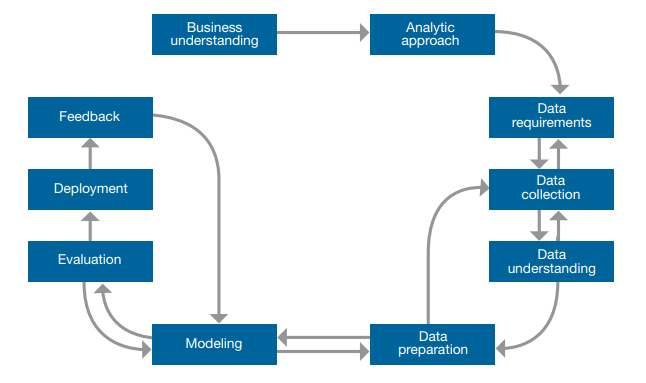

# Business understanding

.

# Analytic approach

.

# Data collection

In [56]:
import warnings
warnings.filterwarnings('ignore')

# Basic Library
import warnings
import os
import numpy as np
np.random.seed(7)
import pandas as pd
import statistics
import math
from timeit import default_timer as timer

# Preprocessing Library
#!pip install missingno
#import missingno as msno
from sklearn import metrics
from sklearn import preprocessing
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OrdinalEncoder
from sklearn.preprocessing import MinMaxScaler
import vtreat

# Visualization Library
import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline 
import seaborn as sns
from scipy import stats
import missingno as mno

#import matplotlib.pylab as pylab

# Fast EDA
from dataprep.eda import create_report

# Dimentionality Reduction & Normalization Library
#from sklearn.preprocessing import normalize
#from sklearn.preprocessing import MinMaxScaler
#from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Machine Learning Library
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
from sklearn.linear_model import LinearRegression
from catboost import CatBoostRegressor
from xgboost import XGBRegressor
import xgboost as xgb
from sklearn.model_selection import GridSearchCV
import pickle

# Model Evaluation Library
from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
#from sklearn.metrics import classification_report, confusion_matrix, accuracy_score


In [2]:
# Check the version
print(f'Matplotlib: {matplotlib.__version__}')
print(f'pandas: {pd.__version__}')
print(f'numpy: {np.__version__}')

Matplotlib: 3.7.2
pandas: 1.5.3
numpy: 1.25.0


In [3]:
# Get all files in the designated directory
directory_path = r"D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23"

for dirpath, _, filenames in os.walk(directory_path):
    for filename in filenames:
        print(os.path.join(dirpath, filename))

D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.gitignore
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\README.md
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\COMMIT_EDITMSG
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\config
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\description
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\FETCH_HEAD
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\HEAD
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\index
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\ORIG_HEAD
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\packed-refs
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\hooks\applypatch-msg.sample
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\hooks\commit-msg.sample
D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\.git\hooks\fsmonito

In [4]:
# Use double backslashes or forward slashes in the file path
path_train = r'D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\datasets\train.csv'
path_test = r'D:\[03] Work & Project\[01] Active Development\AIRNOLOGY-23\datasets\test.csv'

# Read the CSV file into a DataFrame
train_dat = pd.read_csv(path_train)
test_dat = pd.read_csv(path_test)

# Data preparation

In [5]:
train_dat.columns

Index(['datetime', 'datetime_iso', 'time-zone', 'temp', 'visibility',
       'd_point', 'feels', 'min_temp', 'max_temp', 'prssr', 'sea_level',
       'grnd_level', 'hum', 'wind_spd', 'wind_deg', 'rain_1h', 'rain_3h',
       'snow_1h', 'snow_3h', 'clouds'],
      dtype='object')

In [6]:
test_dat.columns

Index(['datetime', 'datetime_iso', 'time-zone', 'temp', 'visibility',
       'd_point', 'feels', 'min_temp', 'max_temp', 'prssr', 'sea_level',
       'grnd_level', 'hum', 'wind_spd', 'wind_deg', 'rain_3h', 'snow_1h',
       'snow_3h', 'clouds'],
      dtype='object')

In [7]:
# Check unique value
cols = train_dat.columns

for col in cols:
    print(f"{col} \t\n-> number of unique val: {train_dat[col].nunique()} \n-> unique val: {train_dat[col].unique()} \n ----------------- \n")

datetime 	
-> number of unique val: 341880 
-> unique val: [ 283996800  284000400  284004000 ... 1514754000 1514757600 1514761200] 
 ----------------- 

datetime_iso 	
-> number of unique val: 341880 
-> unique val: ['1979-01-01 00:00:00+00:00' '1979-01-01 01:00:00+00:00'
 '1979-01-01 02:00:00+00:00' ... '2017-12-31 21:00:00+00:00'
 '2017-12-31 22:00:00+00:00' '2017-12-31 23:00:00+00:00'] 
 ----------------- 

time-zone 	
-> number of unique val: 1 
-> unique val: [28800] 
 ----------------- 

temp 	
-> number of unique val: 9406 
-> unique val: ['24.75 Celcius' '24.58 C' '26.6 Celcius' ... '136.06 °C' '33.48 Celcius'
 '34.32 C'] 
 ----------------- 

visibility 	
-> number of unique val: 12 
-> unique val: [nan 'unidentified' ' ' '-1m' 'unrecognized' 'unknown' '-1 km' '-1'
 'empty' 'undefined' '-1km' '-1 m' 'missing'] 
 ----------------- 

d_point 	
-> number of unique val: 6121 
-> unique val: ['23.89  C' '23.73 C' '24.06 C' ... '28.13 C' '28.1 Celcius' '126.76°C'] 
 ----------------

In [8]:
def prep_temp(temp):
    if isinstance(temp, str) :
        temp = temp.replace("Celcius", "")
        temp = temp.replace("C", "")
        temp = temp.replace("°", "")
        temp = temp.strip()
    return temp

In [9]:
# datetime -> dihapus karena redundant
train_dat.drop(columns=["datetime"], inplace=True)
test_dat.drop(columns=["datetime"], inplace=True)

In [10]:
# Convert the 'timestamp' column to a datetime object
train_dat['datetime_iso'] = pd.to_datetime(train_dat['datetime_iso'])
test_dat['datetime_iso'] = pd.to_datetime(test_dat['datetime_iso'])

# Extract year, month, day, and hour
train_dat['year'] = train_dat['datetime_iso'].dt.year
train_dat['month'] = train_dat['datetime_iso'].dt.month
train_dat['day'] = train_dat['datetime_iso'].dt.day
train_dat['hour'] = train_dat['datetime_iso'].dt.hour

test_dat['year'] = test_dat['datetime_iso'].dt.year
test_dat['month'] = test_dat['datetime_iso'].dt.month
test_dat['day'] = test_dat['datetime_iso'].dt.day
test_dat['hour'] = test_dat['datetime_iso'].dt.hour

train_dat.drop(columns=["datetime_iso"], inplace=True)
test_dat.drop(columns=["datetime_iso"], inplace=True)

In [11]:
# time-zone -> dihapus karena data bukan unique
train_dat.drop(columns=["time-zone"], inplace=True)
test_dat.drop(columns=["time-zone"], inplace=True)

In [12]:
# prssr

def prep_prssr(prssr):
    if isinstance(prssr, str):
        prssr = prssr.replace("hPa.", "")
        prssr = prssr.replace("hPa", "")
        prssr = prssr.strip()
    return prssr

In [13]:
# sea_level

In [14]:
# grnd_level

In [15]:
# hum

def prep_hum(hum):
    if isinstance(hum, str):
        hum = hum.replace("%", "")
        hum = hum.strip()
    return hum

In [16]:
# wind_spd & wind_deg

def prep_wind(wind):
    if isinstance(wind, str):
        wind = wind.replace("m/s", "")
        wind = wind.replace("°", "")
        wind = wind.strip()
    return wind

In [28]:
# rain_1h

def prep_rain_1h(rain):
    if isinstance(rain, str):
        rain = rain.replace("mm", "")
        rain = rain.replace("zero", "0")
        rani = rain.replace(" ", "0")
        rain = rain.strip()
        try:
            float(rain)
            return rain
        except:
            new_rain = 0
            return new_rain
    return rain

In [29]:
# rain_3h -> 0 artinya ga hujan

def prep_rain_3h(rain):
    if isinstance(rain, str):
        rain = rain.replace("milimeter", "")
        rain = rain.replace("mm", "")
        rain = rain.replace("no-rain", "0")
        rain = rain.replace("volume:0", "0")
        rain = rain.replace("nol", "0")
        rain = rain.replace("no_rain", "0")
        rain = rain.replace("volume:zero", "0")
        rain = rain.replace("zero", "0")
        rain = rain.strip()
    return rain

In [30]:
# snow_1h

def prep_snow(snow):
    if isinstance(snow, str):
        snow = snow.replace("milimeter", "")
        snow = snow.replace("mm", "")
        snow = snow.replace("no-snow", "0")
        snow = snow.replace("volume:0", "0")
        snow = snow.replace("nol", "0")
        snow = snow.replace("no_snow", "0")
        snow = snow.replace("volume:zero", "0")
        snow = snow.replace("zero", "0")
        snow = snow.strip()
    return snow

In [31]:
# clouds

def prep_clouds(clouds):
    if isinstance(clouds, str):
        clouds = clouds.replace("%", "")
        clouds = clouds.strip()
    return clouds

In [32]:
preped_train = train_dat.copy()
preped_test = test_dat.copy()

# Prepping temp column --> including temp, d_point, feels, min_temp, max_temp
for column in ['temp','d_point','feels','min_temp','max_temp']:
    preped_train[column] = preped_train[column].apply(lambda x: prep_temp(x))
    preped_test[column] = preped_test[column].apply(lambda x: prep_temp(x))

# Prepping prssr column
for column in ['prssr']:
    preped_train[column] = preped_train[column].apply(lambda x:prep_prssr(x))
    preped_test[column] = preped_test[column].apply(lambda x:prep_prssr(x))

# Prepping hum column
for column in ['hum']:
    preped_train[column] = preped_train[column].apply(lambda x:prep_hum(x))
    preped_test[column] = preped_test[column].apply(lambda x:prep_hum(x))

# Prepping wind column --> including wind_spd, wind_deg
for column in ['wind_spd', 'wind_deg']:
    preped_train[column] = preped_train[column].apply(lambda x:prep_wind(x))
    preped_test[column] = preped_test[column].apply(lambda x:prep_wind(x))

# Prepping rain_1h
for column in ['rain_1h']:
    preped_train[column] = preped_train[column].apply(lambda x:prep_rain_1h(x))

# Prepping rain_3h column
for column in ['rain_3h']:
    preped_train[column] = preped_train[column].apply(lambda x:prep_rain_3h(x))
    preped_test[column] = preped_test[column].apply(lambda x:prep_rain_3h(x))

# Prepping snow column --> including snow_1h, snow_3h
for column in ['snow_1h', 'snow_3h']:
    preped_train[column] = preped_train[column].apply(lambda x:prep_snow(x))
    preped_test[column] = preped_test[column].apply(lambda x:prep_snow(x))

# Prepping clunds column
for column in ['clouds']:
    preped_train[column] = preped_train[column].apply(lambda x:prep_clouds(x))
    preped_test[column] = preped_test[column].apply(lambda x:prep_clouds(x))

In [33]:
# Check unique value
cols = preped_train.columns

for col in cols:
    print(f"{col} \t\n-> number of unique val: {preped_train[col].nunique()} \n-> unique val: {preped_train[col].unique()} \n ----------------- \n")

temp 	
-> number of unique val: 2206 
-> unique val: ['24.75' '24.58' '26.6' ... '158.6' '159.75' '34.32'] 
 ----------------- 

visibility 	
-> number of unique val: 12 
-> unique val: [nan 'unidentified' ' ' '-1m' 'unrecognized' 'unknown' '-1 km' '-1'
 'empty' 'undefined' '-1km' '-1 m' 'missing'] 
 ----------------- 

d_point 	
-> number of unique val: 1519 
-> unique val: ['23.89' '23.73' '24.06' ... '28.08' '28.69' '28.53'] 
 ----------------- 

feels 	
-> number of unique val: 2805 
-> unique val: ['25.76' '25.57' '26.6' ... '41.32' '187.52' '189.53'] 
 ----------------- 

min_temp 	
-> number of unique val: 2107 
-> unique val: ['24.28' '23.99' '26.1' ... '149.19' '146.78' '148.74'] 
 ----------------- 

max_temp 	
-> number of unique val: 2307 
-> unique val: ['25.22' '25.26' '27.39' ... '35.4' '169.91' '177.66'] 
 ----------------- 

prssr 	
-> number of unique val: 47 
-> unique val: ['1012' '1011' '1010' '1010.0' '1009' '1012.0' '1013.0' '1013' '1011.0'
 '1008' '1009.0' '5080

## Making sure the datatypes are correct

* Numerical columns --> int or float
* Categorical columns --> categorical

In [34]:
preped_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 341880 entries, 0 to 341879
Data columns (total 21 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   temp        341880 non-null  object
 1   visibility  51112 non-null   object
 2   d_point     341880 non-null  object
 3   feels       341880 non-null  object
 4   min_temp    341880 non-null  object
 5   max_temp    341880 non-null  object
 6   prssr       341880 non-null  object
 7   sea_level   192964 non-null  object
 8   grnd_level  192919 non-null  object
 9   hum         341880 non-null  object
 10  wind_spd    341880 non-null  object
 11  wind_deg    341880 non-null  object
 12  rain_1h     341880 non-null  object
 13  rain_3h     192329 non-null  object
 14  snow_1h     192696 non-null  object
 15  snow_3h     192699 non-null  object
 16  clouds      341880 non-null  object
 17  year        341880 non-null  int64 
 18  month       341880 non-null  int64 
 19  day         341880 non-

In [35]:
preped_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49368 entries, 0 to 49367
Data columns (total 20 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   temp        49368 non-null  object
 1   visibility  7533 non-null   object
 2   d_point     49367 non-null  object
 3   feels       49368 non-null  object
 4   min_temp    49368 non-null  object
 5   max_temp    49368 non-null  object
 6   prssr       49368 non-null  object
 7   sea_level   27694 non-null  object
 8   grnd_level  27866 non-null  object
 9   hum         49368 non-null  object
 10  wind_spd    49368 non-null  object
 11  wind_deg    49368 non-null  object
 12  rain_3h     27841 non-null  object
 13  snow_1h     27666 non-null  object
 14  snow_3h     27803 non-null  object
 15  clouds      49368 non-null  object
 16  year        49368 non-null  int64 
 17  month       49368 non-null  int64 
 18  day         49368 non-null  int64 
 19  hour        49368 non-null  int64 
dtypes: int

* `temp` should be numerical(float).
* `visibility` should be normal categorical --> tetapi ada kemungkinan ordered categorical.
* `d_point` should be numerical(float).
* `feels` should be numerical(float).
* `min_temp` should be numerical(float).
* `max_temp` should be numerical(float).
* `prssr` should be numerical(float).
* `hum` should be numerical(float).
* `wind_spd` should be numerical(float).
* `wind_deg` should be numerical(float).
* `rain_1h` should be numerical(float) --> target variable.
* `rain_3h` should be numerical(float).
* `snow_1h` should be numerical(float).
* `snow_3h` should be numerical(float).
* `clouds` should be numerical(float).
* `year` should be normal categorical.
* `month` should be normal categorical.
* `hour` should be normal categorical.

In [36]:
preped_train.columns

Index(['temp', 'visibility', 'd_point', 'feels', 'min_temp', 'max_temp',
       'prssr', 'sea_level', 'grnd_level', 'hum', 'wind_spd', 'wind_deg',
       'rain_1h', 'rain_3h', 'snow_1h', 'snow_3h', 'clouds', 'year', 'month',
       'day', 'hour'],
      dtype='object')

In [37]:
# Changing to `category` data type for normal categorical data

cat_cols = ['visibility','sea_level', 'grnd_level', 'year', 'month', 'day', 'hour']

preped_train[cat_cols] = preped_train[cat_cols].astype('category')
preped_test[cat_cols] = preped_train[cat_cols].astype('category')

In [41]:
# Changing to 'float' for numerical data

# di num_cols_test ga ada rain_1h
num_cols_train = ['temp', 'd_point', 'feels', 'min_temp', 'max_temp', 'prssr', 'hum', 'wind_spd', 'wind_deg', 'rain_1h', 'rain_3h', 'snow_1h', 'snow_3h', 'clouds']
num_cols_test = ['temp', 'd_point', 'feels', 'min_temp', 'max_temp', 'prssr', 'hum', 'wind_spd', 'wind_deg', 'rain_3h', 'snow_1h', 'snow_3h', 'clouds']


preped_train[num_cols_train] = preped_train[num_cols_train].astype('float')
preped_test[num_cols_test] = preped_test[num_cols_test].astype('float')

In [42]:
preped_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 341880 entries, 0 to 341879
Data columns (total 21 columns):
 #   Column      Non-Null Count   Dtype   
---  ------      --------------   -----   
 0   temp        341880 non-null  float64 
 1   visibility  51112 non-null   category
 2   d_point     341880 non-null  float64 
 3   feels       341880 non-null  float64 
 4   min_temp    341880 non-null  float64 
 5   max_temp    341880 non-null  float64 
 6   prssr       341880 non-null  float64 
 7   sea_level   192964 non-null  category
 8   grnd_level  192919 non-null  category
 9   hum         341880 non-null  float64 
 10  wind_spd    341880 non-null  float64 
 11  wind_deg    341880 non-null  float64 
 12  rain_1h     341880 non-null  float64 
 13  rain_3h     192329 non-null  float64 
 14  snow_1h     192696 non-null  float64 
 15  snow_3h     192699 non-null  float64 
 16  clouds      341880 non-null  float64 
 17  year        341880 non-null  category
 18  month       341880 non-n

In [43]:
preped_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 49368 entries, 0 to 49367
Data columns (total 20 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   temp        49368 non-null  float64 
 1   visibility  7300 non-null   category
 2   d_point     49367 non-null  float64 
 3   feels       49368 non-null  float64 
 4   min_temp    49368 non-null  float64 
 5   max_temp    49368 non-null  float64 
 6   prssr       49368 non-null  float64 
 7   sea_level   27631 non-null  category
 8   grnd_level  27826 non-null  category
 9   hum         49368 non-null  float64 
 10  wind_spd    49368 non-null  float64 
 11  wind_deg    49368 non-null  float64 
 12  rain_3h     27841 non-null  float64 
 13  snow_1h     27666 non-null  float64 
 14  snow_3h     27803 non-null  float64 
 15  clouds      49368 non-null  float64 
 16  year        49368 non-null  category
 17  month       49368 non-null  category
 18  day         49368 non-null  category
 19  hour

# Data understanding

## Fast EDA

### DataPrep

  0%|                                                                                         | 0/3093 [00:00<…

DataPrep Report
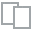
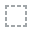
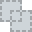
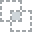
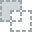
...
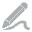
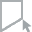
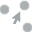
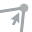
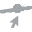

In [44]:
create_report(preped_train)

### ydata_profiling

In [45]:
from ydata_profiling import ProfileReport
profile = ProfileReport(df=preped_train)
profile.to_notebook_iframe()

Pandas backend loaded 1.5.3
Numpy backend loaded 1.25.0
Pyspark backend NOT loaded
Python backend loaded


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

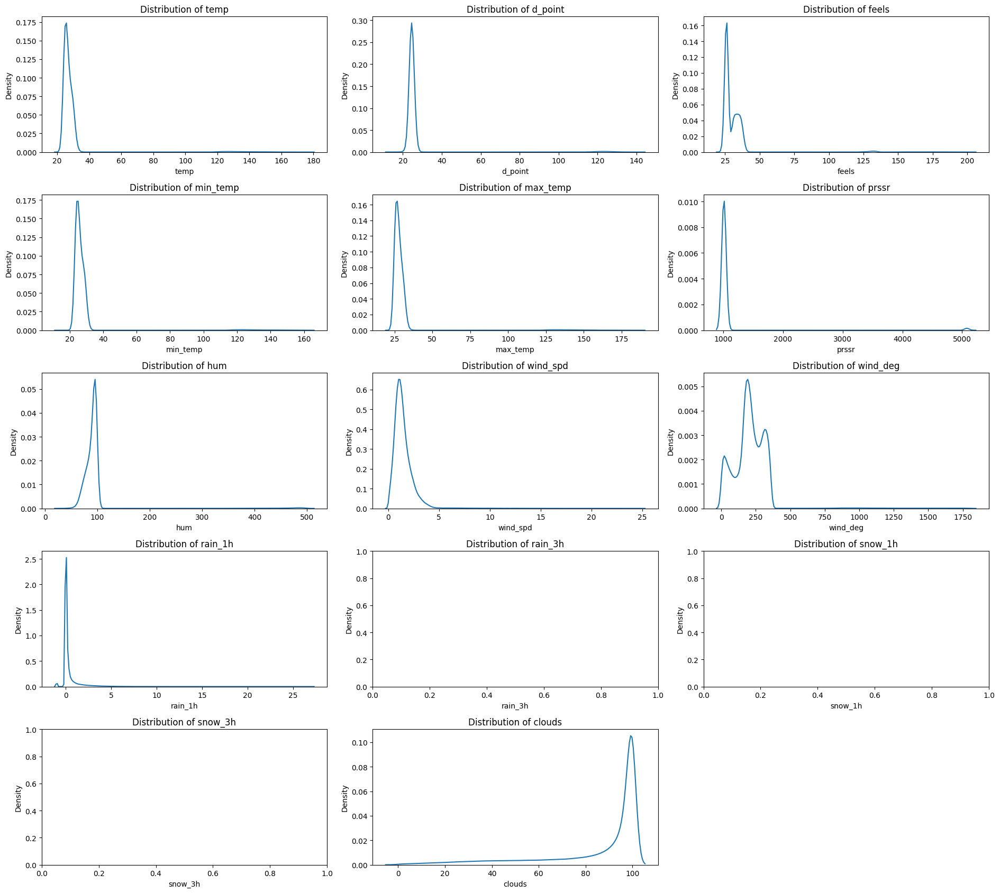

In [47]:
# Filter the DataFrame to include only numerical columns
numerical_columns = preped_train.select_dtypes(include=['number'])

# Determine the number of rows and columns for subplots dynamically
num_numerical_cols = len(numerical_columns.columns)
num_subplot_cols = 3  # Number of columns for subplots

num_subplot_rows = (num_numerical_cols + num_subplot_cols - 1) // num_subplot_cols  # Calculate number of rows

# Create subplots
plt.figure(figsize=(19, 17))
for i, column in enumerate(numerical_columns.columns):
    plt.subplot(num_subplot_rows, num_subplot_cols, i + 1)
    sns.kdeplot(data=numerical_columns[column])
    plt.title(f'Distribution of {column}')

plt.tight_layout()
plt.show()


<Axes: >

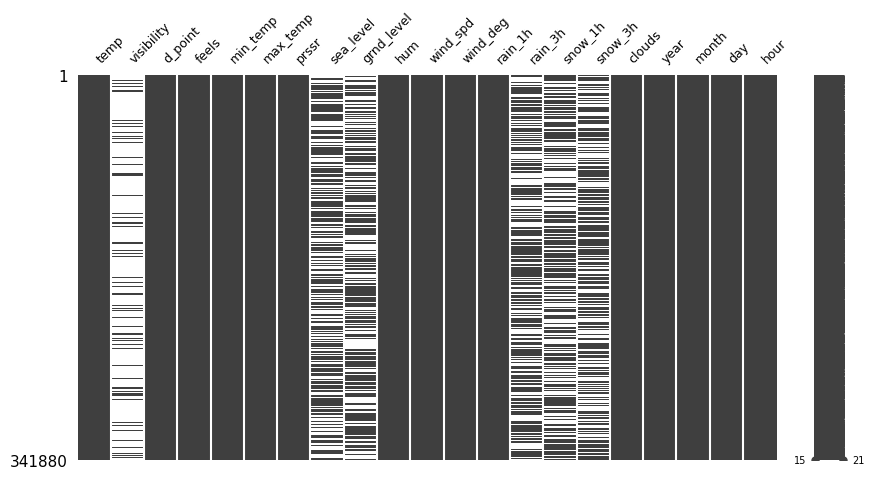

In [58]:
mno.matrix(preped_train, figsize=(10, 5), fontsize=9)

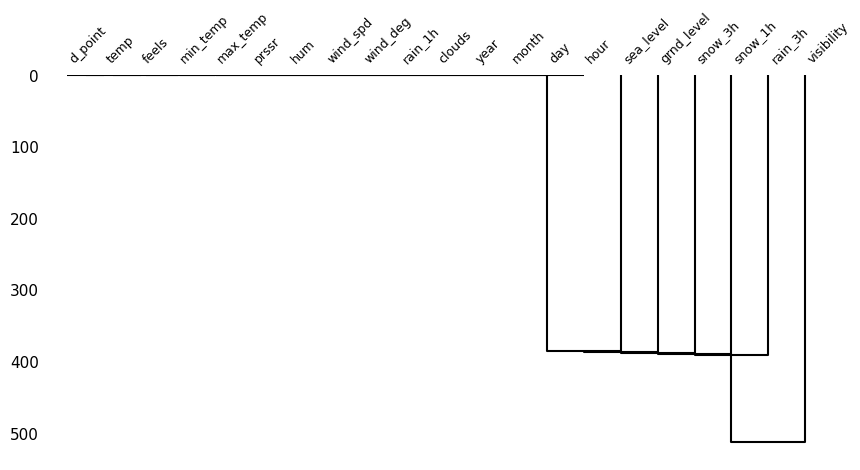

In [59]:
mno.dendrogram(train_dat, figsize=(10,5), fontsize=9);

<Axes: >

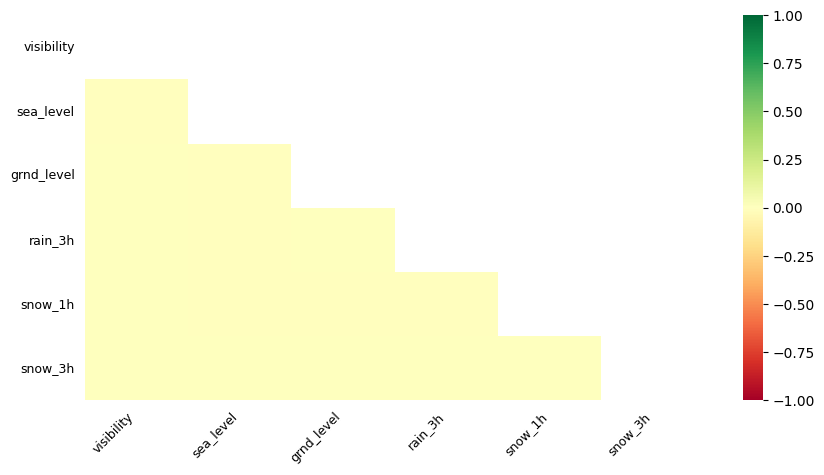

In [60]:
mno.heatmap(train_dat, cmap="RdYlGn", figsize=(10, 5), fontsize=9)

# Data preparation II

In [66]:
transform = vtreat.NumericOutcomeTreatment(
    outcome_name="rain_1h",
    params=vtreat.vtreat_parameters({
        "missingness_imputation": np.mean
    })
)

In [67]:
transformed_train = transform.fit_transform(preped_train)

# Machine Learning I